If this notebook is being run in Colab, we will git clone the repo that this notebooks is taken from to access our files.

In [ ]:
import subprocess

try:
  import google.colab
  IN_COLAB = True
except:
  IN_COLAB = False

if IN_COLAB:
  print(subprocess.check_output(['git', 'clone', 'https://github.com/ivillar/DeepDeMix.git']))

b''


In [ ]:
# This mounts your Google Drive to the Colab VM.
from google.colab import drive
drive.mount('/content/drive')

# TODO: Enter the foldername in your Drive where you have saved the unzipped
# assignment folder, e.g. 'cs231n/assignments/assignment3/'
FOLDERNAME = "CS230/"
assert FOLDERNAME is not None, "[!] Enter the foldername."

# Now that we've mounted your Drive, this ensures that
# the Python interpreter of the Colab VM can load
# python files from within it.
import sys
sys.path.append('/content/drive/My Drive/{}'.format(FOLDERNAME))

Mounted at /content/drive


Run the following cell if this notebook is on Colab:

In [ ]:
!unzip drive/MyDrive/"CS230 Project"/MUSDB18-7-STEMS.zip -d DeepDeMix/unformatted

Archive:  drive/MyDrive/CS230 Project/MUSDB18-7-STEMS.zip
   creating: DeepDeMix/unformatted/test/
  inflating: DeepDeMix/unformatted/test/Cristina Vane - So Easy.stem.mp4  
  inflating: DeepDeMix/unformatted/test/Louis Cressy Band - Good Time.stem.mp4  
  inflating: DeepDeMix/unformatted/test/Secretariat - Borderline.stem.mp4  
  inflating: DeepDeMix/unformatted/test/James Elder & Mark M Thompson - The English Actor.stem.mp4  
  inflating: DeepDeMix/unformatted/test/Georgia Wonder - Siren.stem.mp4  
  inflating: DeepDeMix/unformatted/test/Girls Under Glass - We Feel Alright.stem.mp4  
  inflating: DeepDeMix/unformatted/test/Arise - Run Run Run.stem.mp4  
  inflating: DeepDeMix/unformatted/test/M.E.R.C. Music - Knockout.stem.mp4  
  inflating: DeepDeMix/unformatted/test/Nerve 9 - Pray For The Rain.stem.mp4  
  inflating: DeepDeMix/unformatted/test/The Doppler Shift - Atrophy.stem.mp4  
  inflating: DeepDeMix/unformatted/test/Mu - Too Bright.stem.mp4  
  inflating: DeepDeMix/unformatted

In [ ]:
!mkdir DeepDeMix/data

In [ ]:
%%capture
%cd DeepDeMix
!pip install scaper
!pip install nussl
!pip install git+https://github.com/source-separation/tutorial
!pip install musdb

In [ ]:
from common import data

musdb18_formatted_root = 'data/formatted/'
data.prepare_musdb(folder = musdb18_formatted_root, musdb_root = "unformatted")

/usr/local/lib/python3.7/dist-packages/paramiko/transport.py:236: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,
SoX could not be found!

    If you do not have SoX, proceed here:
     - - - http://sox.sourceforge.net/ - - -

    If you do (or think that you should) have SoX, double-check your
    path variables.
    
100%|██████████| 50/50 [00:39<00:00,  1.25it/s]


Next, we will download our dataset.

In [ ]:
import nussl
import torch
import json
import glob
import numpy as np
from nussl.datasets import transforms as nussl_tfm
from models import MaskInference
from common import utils, data, viz
from pathlib import Path
from train_utils import val_step, train_step

musdb18_formatted_root = './data/formatted/'

# Prepare MUSDB
#data.prepare_musdb(musdb18_formatted_root)

utils.logger()
DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'
MAX_MIXTURES = int(1e8) # We'll set this to some impossibly high number for on the fly mixing.

# parameters for short-time fourier transform
stft_params = nussl.STFTParams(window_length=512, hop_length=128)

# Data Transform
tfm = nussl_tfm.Compose([
    nussl_tfm.MagnitudeSpectrumApproximation(), # generate magnitude spectra
    nussl_tfm.ToSeparationModel(), # convert spectra to tensors
])

# location of training data
train_folder = musdb18_formatted_root + "train"
val_folder = musdb18_formatted_root + "valid"

# create data generator for training data
train_data = data.on_the_fly(stft_params, transform=tfm, 
    fg_path=train_folder, num_mixtures=6000, coherent_prob=1.0)
train_dataloader = torch.utils.data.DataLoader(
    train_data, num_workers=1, batch_size=16)

# create data generator for validation data
val_data = data.on_the_fly(stft_params, transform=tfm, 
    fg_path=val_folder, num_mixtures=300, coherent_prob=1.0)
val_dataloader = torch.utils.data.DataLoader(
    val_data, num_workers=1, batch_size=16)

# define the number of features
nf = stft_params.window_length // 2 + 1
model = MaskInference.build(nf, 1, 50, 1, True, 0.0, 4, 'sigmoid')
model.to(DEVICE)

# define loss function and optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
loss_fn = nussl.ml.train.loss.L1Loss()

def train_step_wrapped(engine, batch):
    return train_step(model, loss_fn, optimizer, engine, batch)

def val_step_wrapped(engine, batch):
    return val_step(model, loss_fn, engine, batch)

# Create the engines
trainer, validator = nussl.ml.train.create_train_and_validation_engines(
    train_step_wrapped, val_step_wrapped, device=DEVICE
)

# We'll save the output relative to this notebook.
output_folder = Path('.').absolute()

# Adding handlers from nussl that print out details about model training
# run the validation step, and save the models.
nussl.ml.train.add_stdout_handler(trainer, validator)
nussl.ml.train.add_validate_and_checkpoint(output_folder, model, 
    optimizer, train_data, trainer, val_dataloader, validator)
print(f"BTW trainer is of type {type(trainer)}")
print("Currently training...")
trainer.run(
    train_dataloader, 
    epoch_length=10, 
    max_epochs=30
)
print("Finished training.")
print("Now evaluating.")

BTW trainer is of type <class 'ignite.engine.engine.Engine'>
Currently training...
Finished training.
Now evaluating.


'\nseparator = nussl.separation.deep.DeepMaskEstimation(\n    nussl.AudioSignal(), model_path=\'checkpoints/best.model.pth\',\n    device=DEVICE,\n)\n\ntest_folder = musdb18_formatted_root + "test"\ntest_data = data.mixer(stft_params, transform=None, \n    fg_path=test_folder, num_mixtures=MAX_MIXTURES, coherent_prob=1.0)\n\n# Since our model only returns one source, let\'s tack on the\n# residual (which should be accompaniment)\n\ntest_dataset = nussl.datasets.MUSDB18(folder=\'unformatted\', subsets=[\'test\'], transform=None)\n\n# Just do 5 items for speed. Change to 50 for actual experiment.\nfor i in range(50):\n    item = test_dataset[i]\n    separator.audio_signal = item[\'mix\']\n    estimates = separator()\n\n\n    source_keys = list(item[\'sources\'].keys())\n    estimates = {\n        \'bass\': estimates[0],\n        \'drums\': estimates[1],\n        \'other\': estimates[2],\n        \'vocals\': estimates[3],\n    }\n\n    sources = [item[\'sources\'][k] for k in source_keys]

/usr/local/lib/python3.7/dist-packages/nussl/separation/base/separation_base.py:73: UserWarning: input_audio_signal has no data!
  warnings.warn('input_audio_signal has no data!')
/usr/local/lib/python3.7/dist-packages/nussl/core/audio_signal.py:455: UserWarning: Initializing STFT with data that is non-complex. This might lead to weird results!
  warnings.warn('Initializing STFT with data that is non-complex. '


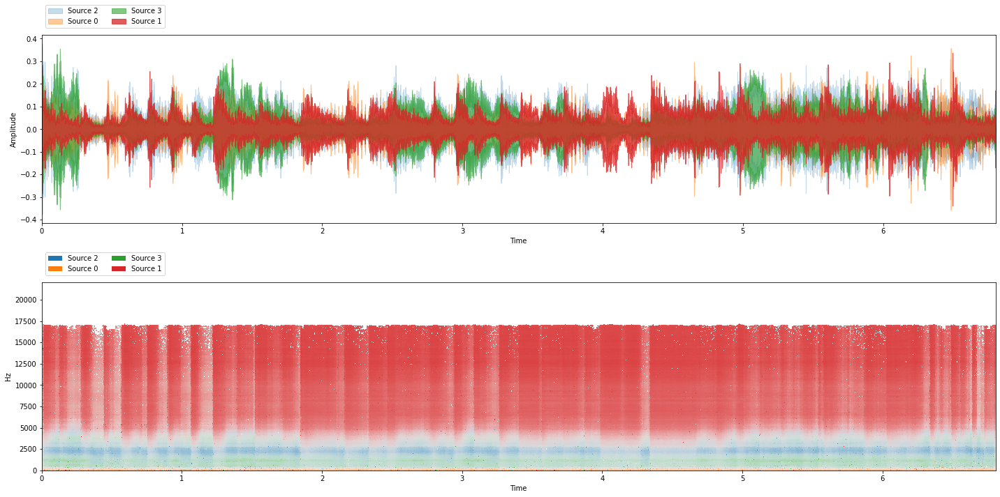


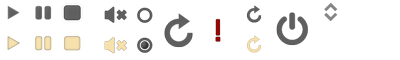
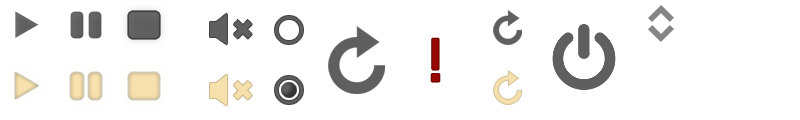
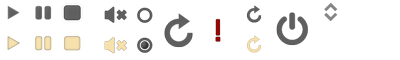

In [9]:
from common import viz
import nussl
import torch

separator = nussl.separation.deep.DeepMaskEstimation(
    nussl.AudioSignal(), model_path='checkpoints/best.model.pth',
    device=DEVICE,
)

test_data = nussl.datasets.MUSDB18(folder='unformatted', subsets=['test'], transform=None)
item = test_data[2]

separator.audio_signal = item['mix']
estimates = separator()
# Since our model only returns one source, let's tack on the
# residual (which should be accompaniment)

viz.show_sources(estimates)

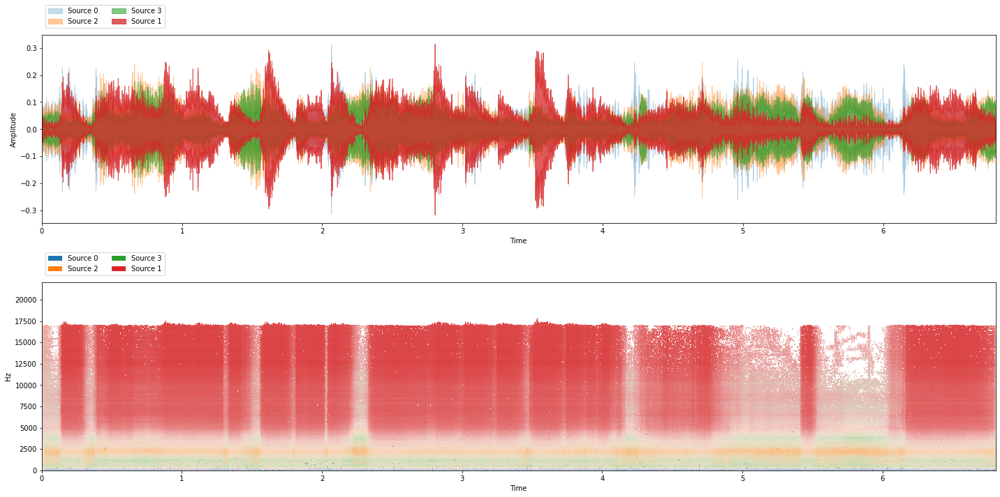


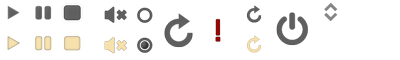
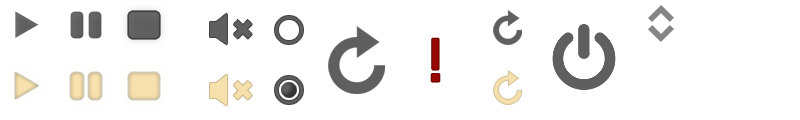
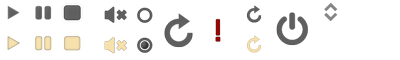

In [12]:
item = test_data[5]

separator.audio_signal = item['mix']
estimates = separator()
# Since our model only returns one source, let's tack on the
# residual (which should be accompaniment)

viz.show_sources(estimates)

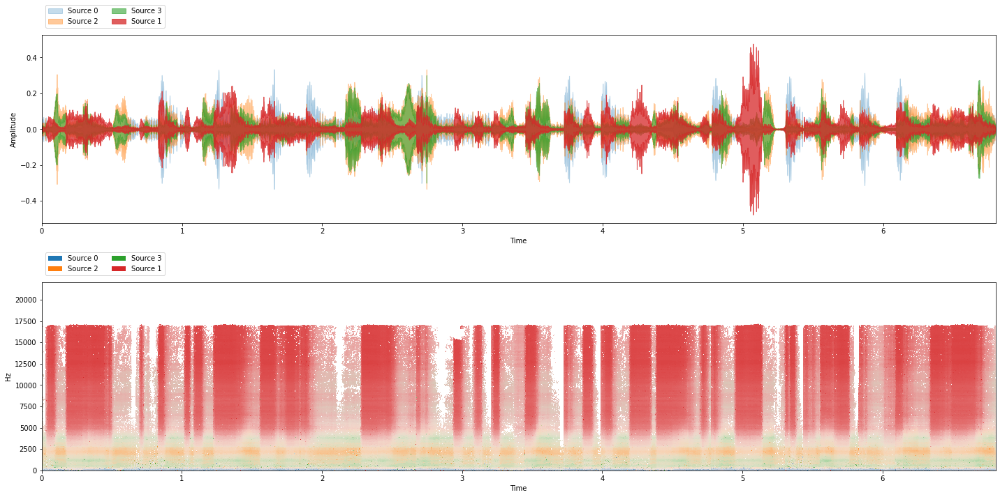


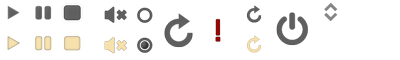
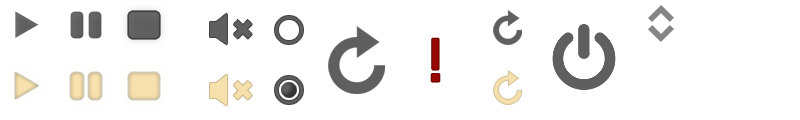
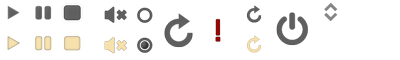

In [13]:
item = test_data[34]

separator.audio_signal = item['mix']
estimates = separator()
# Since our model only returns one source, let's tack on the
# residual (which should be accompaniment)

viz.show_sources(estimates)

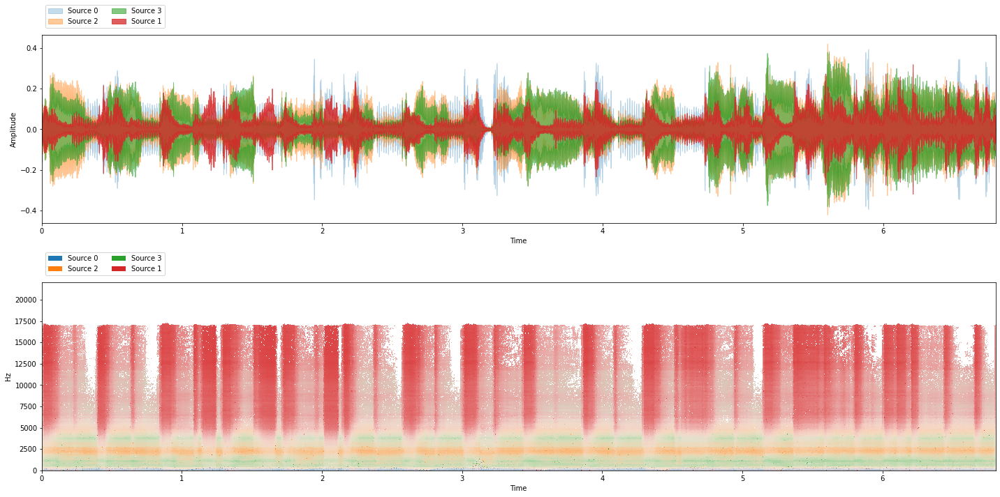


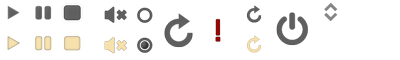
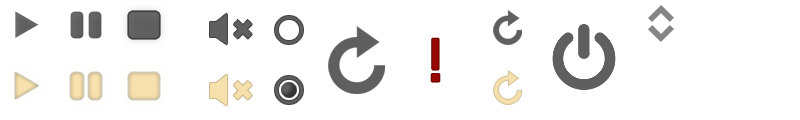
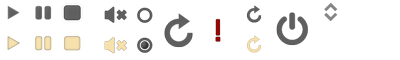

In [14]:
item = test_data[23]

separator.audio_signal = item['mix']
estimates = separator()
# Since our model only returns one source, let's tack on the
# residual (which should be accompaniment)

viz.show_sources(estimates)

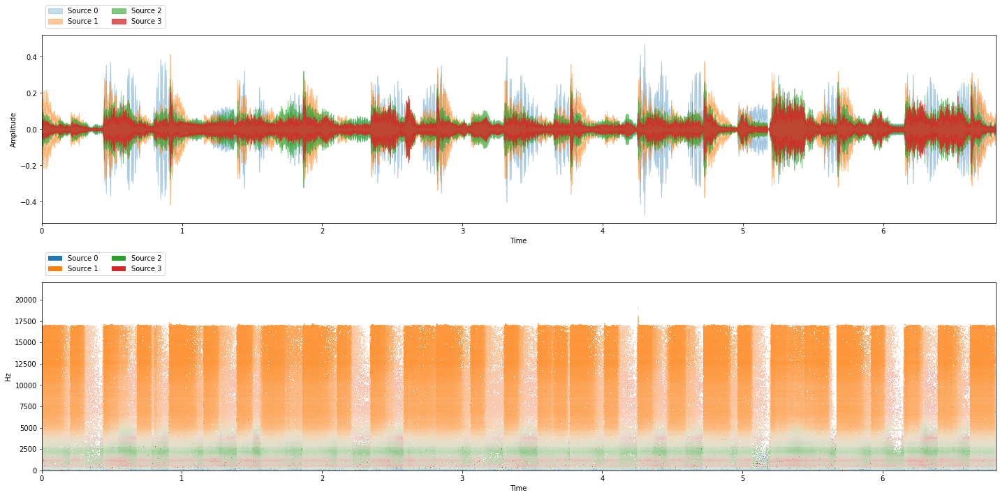


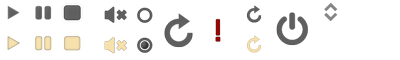
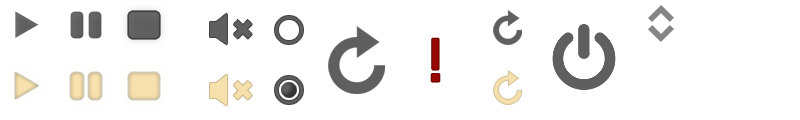
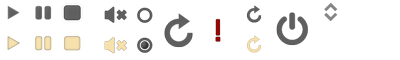

In [23]:
train_data_evaluating = nussl.datasets.MUSDB18(folder='unformatted', subsets=['train'], transform=None)
item = train_data_evaluating[2]

separator.audio_signal = item['mix']
estimates = separator()
# Since our model only returns one source, let's tack on the
# residual (which should be accompaniment)

viz.show_sources(estimates)

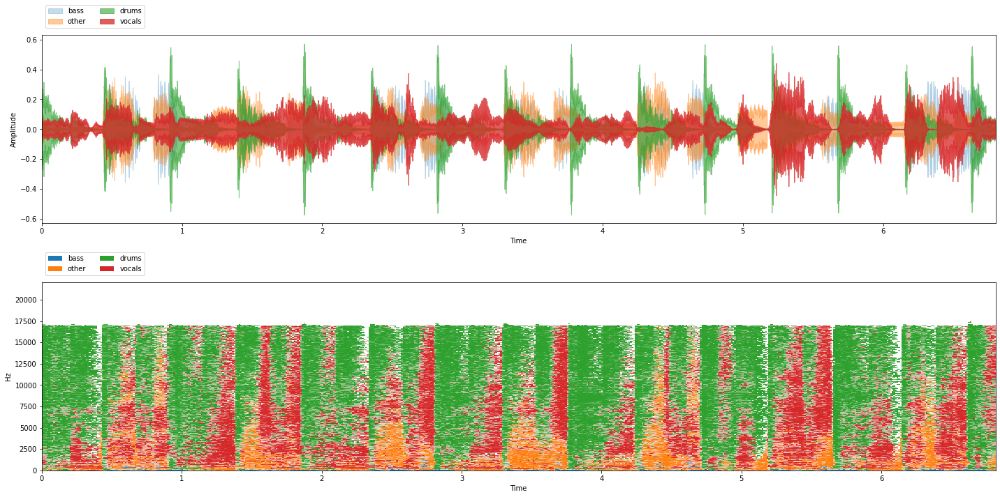


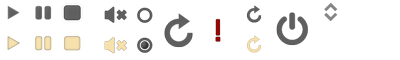
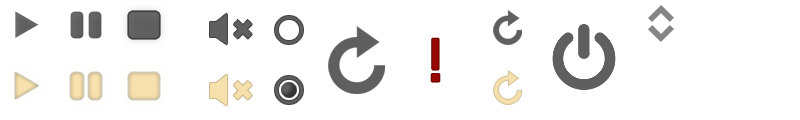
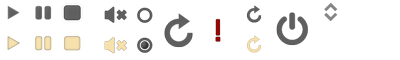

In [22]:
viz.show_sources(item['sources'])

In [ ]:
separator = nussl.separation.deep.DeepMaskEstimation(
    nussl.AudioSignal(), model_path='checkpoints/best.model.pth',
    device=DEVICE,
)

test_dataset = nussl.datasets.MUSDB18(folder='unformatted', subsets=['test'], transform=None)

item = test_dataset[0]
separator.audio_signal = item['mix']
estimates = separator()


source_keys = list(item['sources'].keys())
estimates = {
    'bass': estimates[0],
    'drums': estimates[1],
    'other': estimates[2],
    'vocals': estimates[3],
}

In [24]:
separator = nussl.separation.deep.DeepMaskEstimation(
    nussl.AudioSignal(), model_path='checkpoints/best.model.pth',
    device=DEVICE,
)

# Since our model only returns one source, let's tack on the
# residual (which should be accompaniment)

test_dataset = nussl.datasets.MUSDB18(folder='unformatted', subsets=['test'], transform=None)

# Just do 5 items for speed. Change to 50 for actual experiment.
for i in range(len(test_dataset)):
    item = test_dataset[i]
    separator.audio_signal = item['mix']
    estimates = separator()


    source_keys = list(item['sources'].keys())
    estimates = {
        'bass': estimates[0],
        'drums': estimates[1],
        'other': estimates[2],
        'vocals': estimates[3],
    }

    sources = [item['sources'][k] for k in source_keys]
    estimates = [estimates[k] for k in source_keys]

    evaluator = nussl.evaluation.BSSEvalScale(
        sources, estimates, source_labels=source_keys
    )
    scores = evaluator.evaluate()
    output_folder = Path(output_folder).absolute()
    output_folder.mkdir(exist_ok=True)
    output_file = output_folder / sources[0].file_name.replace('wav', 'json')
    with open(output_file, 'w') as f:
        json.dump(scores, f, indent=4)


json_files = glob.glob(f"*.json")
df = nussl.evaluation.aggregate_score_files(
    json_files, aggregator=np.nanmedian)
nussl.evaluation.associate_metrics(separator.model, df, test_dataset)
report_card = nussl.evaluation.report_card(
    df, report_each_source=True)
print(report_card)

print("Saving model...")
separator.model.save('checkpoints/best.model.pth')

/usr/local/lib/python3.7/dist-packages/nussl/separation/base/separation_base.py:73: UserWarning: input_audio_signal has no data!
  warnings.warn('input_audio_signal has no data!')
/usr/local/lib/python3.7/dist-packages/nussl/core/audio_signal.py:455: UserWarning: Initializing STFT with data that is non-complex. This might lead to weird results!
  warnings.warn('Initializing STFT with data that is non-complex. '


                                                                                                            
                                           MEAN +/- STD OF METRICS                                            
                                                                                                            
┌────────────┬──────────────────┬──────────────────┬──────────────────┬──────────────────┬──────────────────┐
│ METRIC     │     OVERALL      │       BASS       │      DRUMS       │      OTHER       │      VOCALS      │
╞════════════╪══════════════════╪══════════════════╪══════════════════╪══════════════════╪══════════════════╡
│ #          │       200        │        50        │        50        │        50        │        50        │
├────────────┼──────────────────┼──────────────────┼──────────────────┼──────────────────┼──────────────────┤
│ SI-SDR     │  -2.14 +/-  4.22 │  -3.00 +/-  4.60 │  -1.66 +/-  3.27 │  -3.87 +/-  3.23 │  -0.03 +/-  4.64 │
├──────────

/usr/local/lib/python3.7/dist-packages/nussl/evaluation/report_card.py:83: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  for m in np.array(df.mean()).T
/usr/local/lib/python3.7/dist-packages/nussl/evaluation/report_card.py:87: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  for s in np.array(df.std()).T
/usr/local/lib/python3.7/dist-packages/nussl/evaluation/report_card.py:107: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  for m in np.array(df.median()).T


'checkpoints/best.model.pth'

In [27]:
train_dataset = nussl.datasets.MUSDB18(folder='unformatted', subsets=['train'], transform=None)

for i in range(len(train_dataset)):
    item = train_dataset[i]
    separator.audio_signal = item['mix']
    estimates = separator()


    source_keys = list(item['sources'].keys())
    estimates = {
        'bass': estimates[0],
        'drums': estimates[1],
        'other': estimates[2],
        'vocals': estimates[3],
    }

    sources = [item['sources'][k] for k in source_keys]
    estimates = [estimates[k] for k in source_keys]

    evaluator = nussl.evaluation.BSSEvalScale(
        sources, estimates, source_labels=source_keys
    )
    scores = evaluator.evaluate()
    output_folder = Path(output_folder).absolute()
    output_folder.mkdir(exist_ok=True)
    output_file = output_folder / sources[0].file_name.replace('wav', 'json')
    with open(output_file, 'w') as f:
        json.dump(scores, f, indent=4)


json_files = glob.glob(f"*.json")
df = nussl.evaluation.aggregate_score_files(
    json_files, aggregator=np.nanmedian)
nussl.evaluation.associate_metrics(separator.model, df, train_dataset)
report_card = nussl.evaluation.report_card(
    df, report_each_source=True)
print(report_card)

                                                                                                            
                                           MEAN +/- STD OF METRICS                                            
                                                                                                            
┌────────────┬──────────────────┬──────────────────┬──────────────────┬──────────────────┬──────────────────┐
│ METRIC     │     OVERALL      │       BASS       │      DRUMS       │      OTHER       │      VOCALS      │
╞════════════╪══════════════════╪══════════════════╪══════════════════╪══════════════════╪══════════════════╡
│ #          │       576        │       144        │       144        │       144        │       144        │
├────────────┼──────────────────┼──────────────────┼──────────────────┼──────────────────┼──────────────────┤
│ SI-SDR     │  -1.88 +/-  4.61 │  -1.60 +/-  5.32 │  -3.05 +/-  4.38 │  -3.66 +/-  3.38 │   0.78 +/-  3.85 │
├──────────

/usr/local/lib/python3.7/dist-packages/nussl/evaluation/report_card.py:83: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  for m in np.array(df.mean()).T
/usr/local/lib/python3.7/dist-packages/nussl/evaluation/report_card.py:87: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  for s in np.array(df.std()).T
/usr/local/lib/python3.7/dist-packages/nussl/evaluation/report_card.py:107: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  for m in np.array(df.median()).T


In [35]:
print(val_data[0]['source_magnitudes'].shape)

torch.Size([1724, 257, 1, 4])


In [25]:
!zip -r /content/file.zip /content/DeepDeMix

  adding: content/DeepDeMix/ (stored 0%)
  adding: content/DeepDeMix/unformatted/ (stored 0%)
  adding: content/DeepDeMix/unformatted/train/ (stored 0%)
  adding: content/DeepDeMix/unformatted/train/Atlantis Bound - It Was My Fault For Waiting.stem.mp4 (deflated 7%)
  adding: content/DeepDeMix/unformatted/train/Leaf - Summerghost.stem.mp4 (deflated 9%)
  adding: content/DeepDeMix/unformatted/train/Leaf - Come Around.stem.mp4 (deflated 8%)
  adding: content/DeepDeMix/unformatted/train/The Scarlet Brand - Les Fleurs Du Mal.stem.mp4 (deflated 13%)
  adding: content/DeepDeMix/unformatted/train/Steven Clark - Bounty.stem.mp4 (deflated 3%)
  adding: content/DeepDeMix/unformatted/train/Angela Thomas Wade - Milk Cow Blues.stem.mp4 (deflated 12%)
  adding: content/DeepDeMix/unformatted/train/James May - On The Line.stem.mp4 (deflated 13%)
  adding: content/DeepDeMix/unformatted/train/Lushlife - Toynbee Suite.stem.mp4 (deflated 7%)
  adding: content/DeepDeMix/unformatted/train/Snowmine - Curfews